In [4]:
import pandas as pd
import numpy as np
import quantstats as qs
from lightgbm import LGBMRegressor
from sklearn.metrics import accuracy_score
from sklearn.linear_model import RidgeClassifier, LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, GradientBoostingClassifier
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam
from keras.wrappers.scikit_learn import KerasClassifier
from scipy.stats import mode
from keras.losses import BinaryCrossentropy
from numpy.random import seed as np_seed
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.feature_selection import mutual_info_regression, mutual_info_classif
from sklearn.impute import SimpleImputer
import matplotlib.pyplot as plt
#import TimeSeriesAirGapGridSearch as tsgap # time series cross-validation
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
import plotly.express as px
import warnings
from statsmodels.tsa.seasonal import STL
from sklearn.exceptions import UndefinedMetricWarning, ConvergenceWarning
from lightgbm import LGBMClassifier as lgb
import plotly.graph_objects as go
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns
from collections import defaultdict
from sklearn.metrics import mean_squared_error
from datetime import datetime
from collections import defaultdict
from lightgbm import LGBMRegressor
import random
import yfinance as yf
import gc 
from array import array
from sklearn.metrics import mean_squared_error 


random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Ignore all warnings
warnings.filterwarnings('ignore')

# Specifically ignore certain warnings from Scikit-learn
warnings.filterwarnings('ignore', category=UserWarning)
warnings.filterwarnings('ignore', category=UndefinedMetricWarning)
warnings.filterwarnings('ignore', category=ConvergenceWarning)

# Remove errors
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

In [5]:
# Constants
training_window_size = 252 * 3  # 5 years
forecast_window_size = 252 * 1 # 1 year
#training_window_size = 200  # 5 years
#forecast_window_size = 50 # 1 year

# Params
start_date = '2015-02-15'
end_date = '2023-08-25'

portfolio_size = 250000
rolling_window = 200


corr_coef = 0.13
n_lags = 100
info_gain_num_features = 20
horizons = [3]

models = [
    ('LightGBM', lambda: LGBMRegressor(random_state=42)),
]

securities = ["AAPL", "MSFT", "SYF", "AMZN", "GOOGL", "GOOG", "META", "JPM", "V", "PG", "JNJ", "UNH",
              
              "MA", "HD", "NVDA", "VZ", "T", "DIS", "BAC", "PYPL", "INTC", "CMCSA", "ADBE", "CSCO","NFLX", "PFE", "XOM", "IBM",
              "ABBV", "WMT", "MRK", "KO", "PEP", "CRM", "MCD", "BMY",
                "ORCL", "NKE", "CVX", "TMO", "COST", "PM", "PYPL", "AMGN", "ACN", "C", "HON", "NEE",
                "ABT", "TXN", "AVGO", "QCOM", "DHR", "LIN", "LOW", "UNP", "LLY", "WFC", "CME", "UPS",
                "AXP", "GILD", "CHTR", "SBUX", "MDT", "RTX", "INTU", "MO", "BLK", "CAT", "PLD", "LMT",
                "AMAT", "FIS", "SPGI", "CVS", "TGT", "BKNG", "BK", "ISRG", "GS", "SCHW", "CL", "CI", "ICE", "BIIB", "DUK", "SYK", "CCI", "AON", "BDX", "MMM", "REGN",
                "CSX", "EW", "DE", "ATVI", "FDX", "MET", "ADI", "BDX", "ES", "AEP", "VRTX", "SYY", "D",
                "EA", "TMUS", "ADM", "NEM", "APD", "PNC", "CLX", "EBAY", "ECL", "SO", "ETN", "COF",
                "MMC", "CI", "AMT", "PGR", "FDX", "CCL", "GPN", "BIIB", "KMB", "SWK", "AZO",
                "ADSK", "ITW", "AMCR", "WBA", "RMD", "ADP", "CTAS", "EQIX", "EFX", "PAYX",
                "NOC", "AFL", "MCO", "KLAC", "COO", "LYB", "KEYS", "CDNS", "MNST", "REG", "GLW", 
                "UAL", "HAL", "PCAR", "VRSK", "STZ", "ETR", "KMI", "BAX", "HUM", "TEL"]

"""
    "J", "PH", "MKC", "AVB", "EXC", "CTLT", "FTNT", "AMP", "SWKS", "ALL", "MCHP", "PRU", "PEG",
    "MTD", "RF", "WEC", "PKI", "ANSS", "HBAN"]
"""

import yahoo_fin.stock_info as si
#securities = si.tickers_sp500()

# Convert to datetime objects
start_date_dt = datetime.strptime(start_date, '%Y-%m-%d')
end_date_dt = datetime.strptime(end_date, '%Y-%m-%d')

# Check that training_window_size + forecast_window_size < (end_date - start_date)
total_days = (end_date_dt - start_date_dt).days
assert training_window_size + forecast_window_size < total_days, "Training and forecast window sizes are too large for the given date range"

In [6]:
def rmspe(y_true, y_pred):
    return np.sqrt(np.mean(((y_true - y_pred) / y_true) ** 2))

# Define functions for data processing, feature engineering, etc.
def create_model():
    model = Sequential()
    model.add(Dense(64, input_dim=n_lags, activation='relu'))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(16, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=Adam(learning_rate=0.01), loss=BinaryCrossentropy(), metrics=['accuracy'])
    return model


def process_data(df):
    for i in range(n_lags):
        df[f'lag_{i+1}'] = df['Close'].shift(i+1)
    df['Close_diff'] = df['Close'].diff().apply(np.sign)
    df = df.dropna()
    df['Date'] = pd.to_datetime(df['Date'])

    return df

def log_values(df):
    for col in df.columns:
        if col == 'Date':
            break
        df[f'log_{col}'] = np.log(df[col].replace(0, 1e-100)) # 1e-100 to avoid 0 division
    
    return df

def one_three_five_day_returns(df, periods, log=False):

    for col in df.columns:
        if col == 'Date':
            break
        for period in periods:
            # Create the n-day return column
            df[f'{col}_{period}_day_return'] = df[col].pct_change(periods=period)
    
    return df

def five_ten_twenty_day_moving_average(df,periods):
    
    new_cols = []
    for col in df.columns:
        for period in periods:
            if col == 'Date':
                break
            new_cols.append(df[col].rolling(period).mean().rename(f'{col}_{period}_moving_avg'))
    
    df = pd.concat([df] + new_cols, axis=1)
    
    return df

def extract_day_month_bool(df):
    
    # Extract month and day components
    df['month'] = df['Date'].dt.month
    df['day'] = df['Date'].dt.day

    # One-hot encode month and day columns
    df = pd.get_dummies(df, columns=['month', 'day'])
    
    # Check for missing day and month columns and add them if they don't exist
    for day in range(1, 32):  # days from 1 to 31
        if f'day_{day}' not in df.columns:
            df[f'day_{day}'] = 0
    for month in range(1, 13):  # months from 1 to 12
        if f'month_{month}' not in df.columns:
            df[f'month_{month}'] = 0
        
    return df
   
def calculate_stl_decomposition(df, column_name='Close', period=12):

    # Perform STL decomposition
    stl = STL(df[column_name].dropna(), seasonal=13, period=period)
    result = stl.fit()

    # Add the components to the data frame
    df['trend_stl'] = result.trend
    df['seasonal_stl'] = result.seasonal
    df['resid_stl'] = result.resid
    return df

def generate_features(df):
    
    # Create log values
    df = log_values(df.copy())
    
    # 1,3,5 day returns of all features
    df = one_three_five_day_returns(df.copy(),periods=[1,3,5,10,20])
    
    # 5, 10, 20 day MA of all features
    df = five_ten_twenty_day_moving_average(df.copy(), periods=[5,10,20,30,50])
        
    # extract day and month from date
    df = extract_day_month_bool(df.copy())

    # STL decomposition
    df = calculate_stl_decomposition(df.copy())
    
    return df

def filter_info_gains_features(df, horizon, num_features, info_gain=False):

    # Create the target variable based on the given horizon
    target_asset_horizon = df['Close'].rolling(window=horizon).sum().shift(-horizon)
    target_asset_horizon = target_asset_horizon[:-horizon]

    # Exclude the last 'horizon' rows from 'df' and 'Close'
    df_horizon = df.iloc[:-horizon].drop(columns=['Close'])

    # Create a mask to keep rows where both the features and target are not NaN
    mask_notna = target_asset_horizon.notna() & df_horizon.drop(columns=['Date']).notna().all(axis=1)
    
    # Keep only the rows where both the features and target are not NaN
    X_all = df_horizon[mask_notna]
    dates = df_horizon['Date'][mask_notna].copy()
    X_all = df_horizon[mask_notna].drop(columns=['Date'])
    y = target_asset_horizon[mask_notna]

    if info_gain == True:
        # Calculate mutual information between each feature and the target variable
        mutual_info = mutual_info_regression(X_all, y)

        # Store feature importance values in a dictionary
        feature_importance = {feature: importance for feature, importance in zip(X_all.columns, mutual_info)}

        # Sort dictionary by value
        sorted_feature_importance = dict(sorted(feature_importance.items(), key=lambda x: x[1], reverse=True))

        # Get the names of the top num_features
        top_features = list(sorted_feature_importance.keys())[:num_features]

        # Filter the training and testing sets using the top features
        X_all_filtered = X_all[top_features]

        return {
            'X': X_all_filtered, 
            'y': y, 
            'dates': dates,
            'features': top_features
        }
    else:
        return {
            'X': X_all, 
            'y': y, 
            'dates': dates
        }

security AAPL
security MSFT
security SYF
security AMZN
security GOOGL
security GOOG
security META
security JPM
security V
security PG
security JNJ
security UNH
security MA
security HD
security NVDA
security VZ
security T
security DIS
security BAC
security PYPL
security INTC
security CMCSA
security ADBE
security CSCO
security NFLX
security PFE
security XOM
security IBM
security ABBV
security WMT
security MRK
security KO
security PEP
security CRM
security MCD
security BMY
security ORCL
security NKE
security CVX
security TMO
security COST
security PM
security PYPL
security AMGN
security ACN
security C
security HON
security NEE
security ABT
security TXN
security AVGO
security QCOM
security DHR
security LIN
security LOW
security UNP
security LLY
security WFC
security CME
security UPS
security AXP
security GILD
security CHTR
security SBUX
security MDT
security RTX
security INTU
security MO
security BLK
security CAT
security PLD
security LMT
security AMAT
security FIS
security SPGI
security C

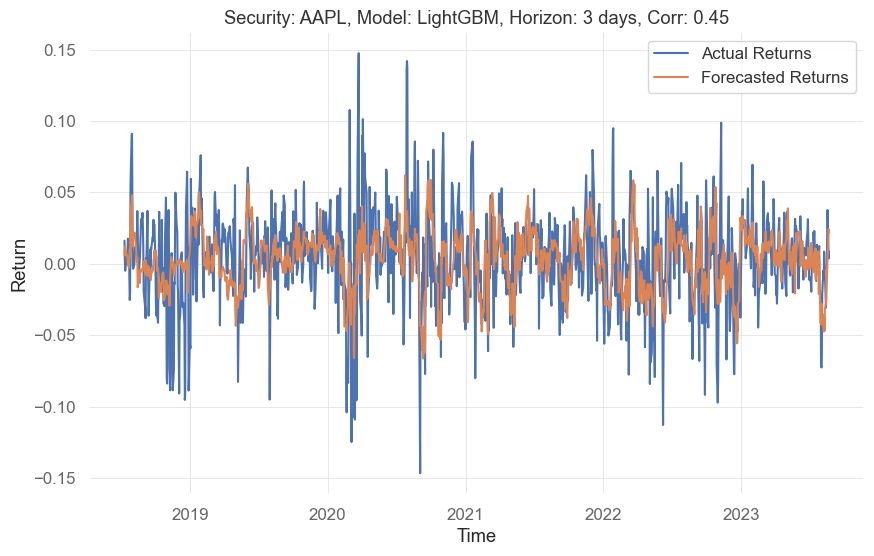

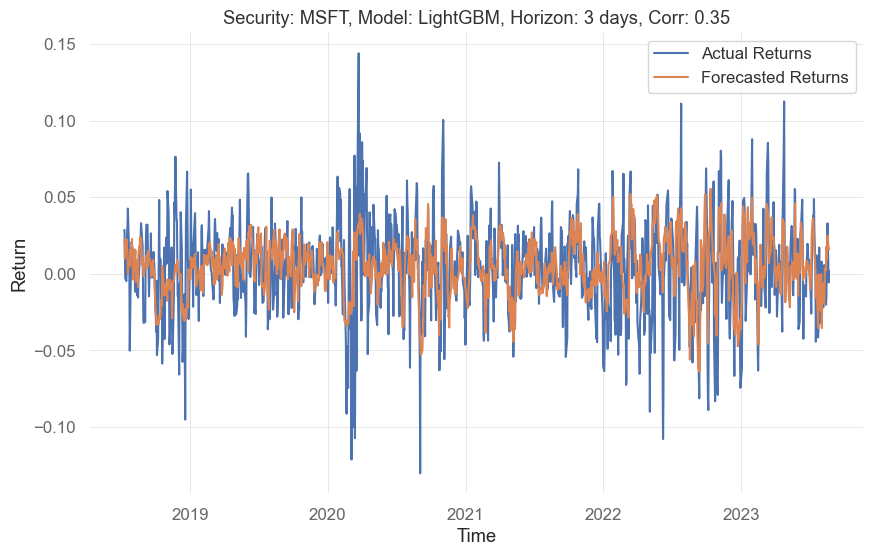

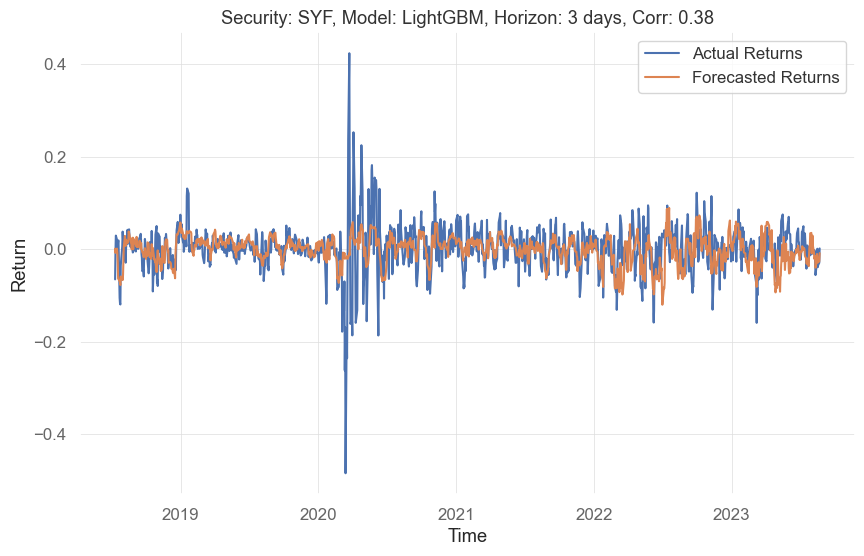

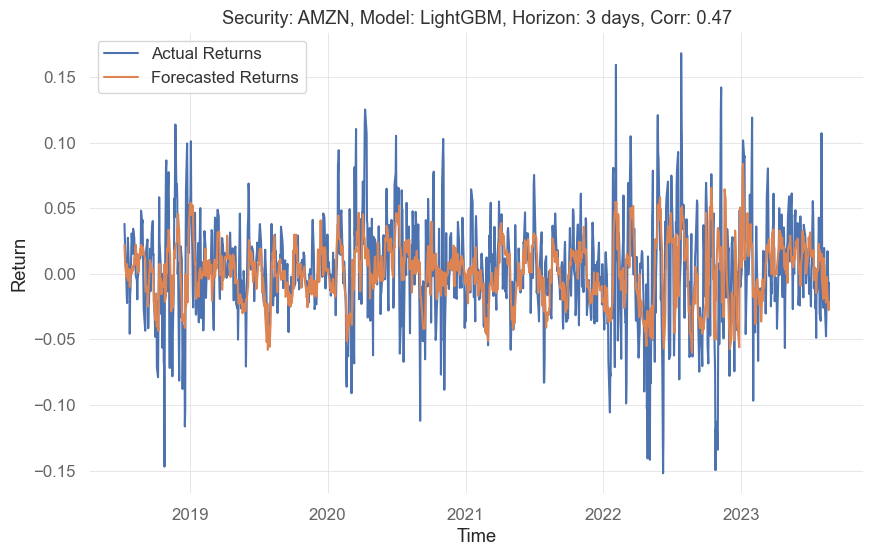

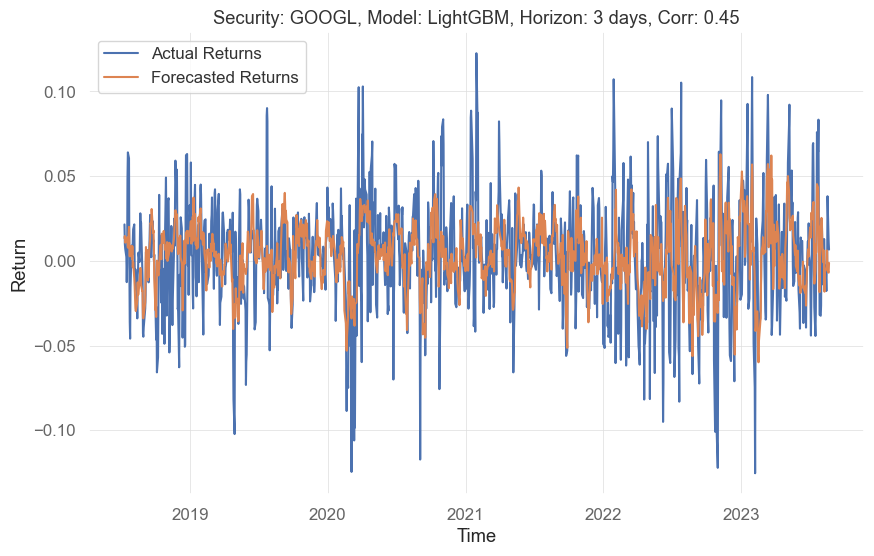

...

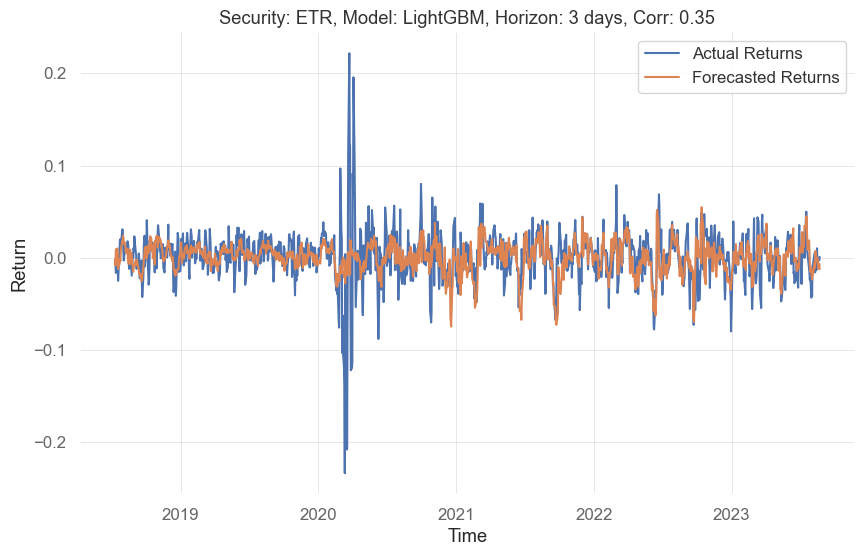

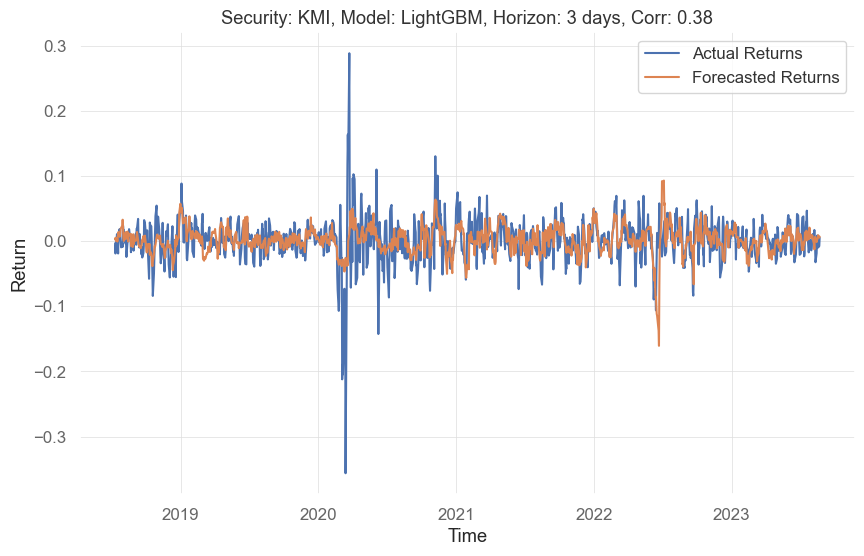

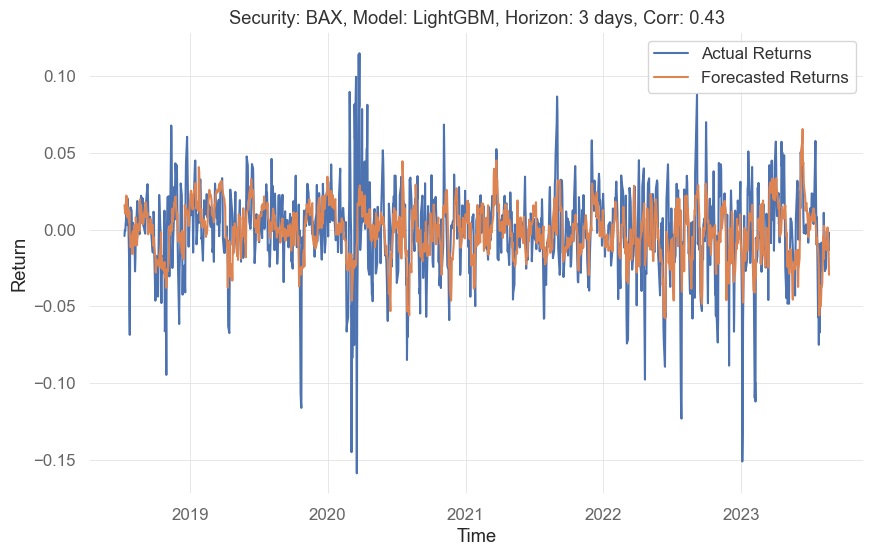

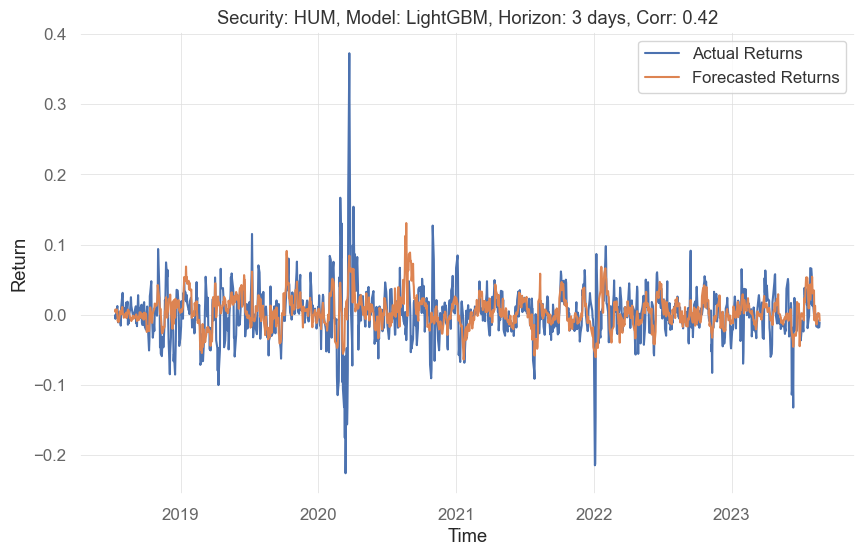

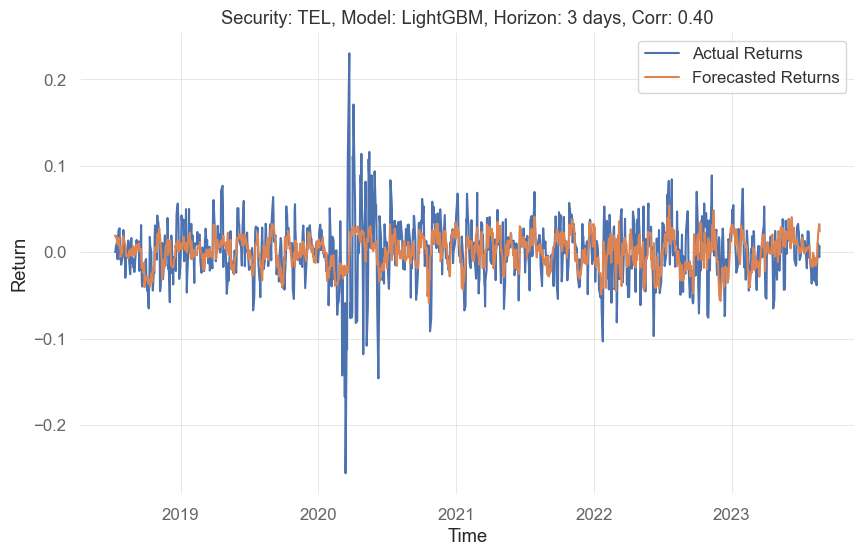

In [7]:
# Initialize variables to store performance metrics and forecasts
forecasts_per_model = {}
securities_high_corr = set()
returns_dict = {}
last_end_test = 0

# Loop through securities to download and store returns
for security in securities:
    returns = qs.utils.download_returns(security)
    returns = returns.loc[start_date:end_date]
    returns_dict[security] = returns
    
# Loop through securities
for security in securities:
    print('security', security)
    for horizon in horizons:
        
        # Download and preprocess data for each security
        returns = returns_dict[security]
        df = pd.DataFrame(returns).reset_index()
        df = process_data(df)
        df = generate_features(df)
        
        # Extract the dates for the test window
        extract_dates = filter_info_gains_features(df, horizon, num_features=info_gain_num_features)
        all_dates_window = extract_dates['dates']

        # Loop through the data with rolling windows
        for model_name, model_class in models:
            all_actual_returns = []
            all_forecasted_returns = []
            dates_test_window_all = []
            all_corr, all_mse, all_rmspe = [], [], []

            # Skip if not enough data to train
            if len(all_dates_window) < training_window_size:
                continue
            
            start_idx = 0
            while start_idx < len(all_dates_window): 
                end_idx_train = start_idx + training_window_size
                start_idx_test = end_idx_train
                end_idx_test = start_idx_test + forecast_window_size

                # If this is the last iteration, adjust the indices to cover the remaining data
                if end_idx_test >= len(all_dates_window):
                    end_idx_test = len(all_dates_window)

                    if start_idx > 0: # Update values if not not first iteration
                        start_idx_test = end_idx_test - (end_idx_test - last_end_test)
                        end_idx_train = start_idx_test
                        start_idx = end_idx_train - training_window_size
                        

                sliced_train = df.iloc[start_idx:end_idx_train]
                sliced_test = df.iloc[start_idx_test:end_idx_test]
                
                if sliced_train.empty:
                    print("Skipping empty slice for train indices:", start_idx, "to", end_idx_train)
                    continue
                elif sliced_test.empty:
                    print("Skipping empty slice for test indices:", start_idx_test, "to", end_idx_test)
                    continue
                    
                # Store to use on last batch
                last_end_test = end_idx_test
                
                # Apply Information Gain feature selection to training data only
                X_y_train_datasets = filter_info_gains_features(df.iloc[start_idx:end_idx_train], horizon=horizon, \
                                                      num_features=info_gain_num_features, info_gain=True)

                X_train_window = X_y_train_datasets['X']
                y_train_window = X_y_train_datasets['y']

                if start_idx == 0: # First iteration
                    X_y_test_datasets = filter_info_gains_features(df.iloc[start_idx_test:end_idx_test], horizon=horizon, \
                                                              num_features=info_gain_num_features, info_gain=False)

                elif end_idx_test >= len(all_dates_window): # if last batch, get all data to the end
                    X_y_test_datasets = filter_info_gains_features(df.iloc[start_idx_test-horizon:], horizon=horizon, \
                                                                   num_features=info_gain_num_features, info_gain=False)

                else:
                    X_y_test_datasets = filter_info_gains_features(df.iloc[start_idx_test-horizon:end_idx_test], horizon=horizon, \
                                                                   num_features=info_gain_num_features, info_gain=False)

                # Extract the forecast data
                X_test_window = X_y_test_datasets['X'][X_y_train_datasets['features']]
                y_test_window = X_y_test_datasets['y']

                dates_test_window_for_this_window = X_y_test_datasets['dates']

                # Apply MinMaxScaler to X_train_window and y_train_window
                scaler_X = MinMaxScaler()
                scaler_y = MinMaxScaler()

                X_train_window_scaled = scaler_X.fit_transform(X_train_window)
                y_train_window_scaled = scaler_y.fit_transform(y_train_window.values.reshape(-1, 1))

                # Apply MinMaxScaler to X_test_window and y_test_window
                X_test_window_scaled = scaler_X.transform(X_test_window)
                y_test_window_scaled = scaler_y.transform(y_test_window.values.reshape(-1, 1))

                # Use model class to fit and predict 
                learner = model_class().fit(X_train_window_scaled, y_train_window_scaled.ravel())
                forecasts = learner.predict(X_test_window_scaled)
                
                # Inverse forecasts
                forecasts_rescaled = scaler_y.inverse_transform(forecasts.reshape(-1, 1)).flatten()

                # Append the actual, forecasted returns, and dates for this window
                all_actual_returns.extend(y_test_window.values)
                all_forecasted_returns.extend(forecasts_rescaled)
                dates_test_window_all.extend(dates_test_window_for_this_window.values)
                all_corr.append(np.corrcoef(all_actual_returns, all_forecasted_returns)[0, 1])
                all_mse.append(mean_squared_error(y_test_window, forecasts))
                all_rmspe.append(mean_squared_error(y_test_window, forecasts))

                # Store forecasts and actual returns
                forecasts_per_model[(security, horizon, model_name)] = {
                    'date': dates_test_window_all,
                    'forecast': all_forecasted_returns,
                    'actual': all_actual_returns,
                    'correlation': all_corr,
                    'mse': all_mse,
                    'rmspe': all_rmspe
                }
                
                # Determine if this is the last iteration
                if end_idx_test + forecast_window_size > len(all_dates_window):
                    # Increment by the remaining data points for the last iteration
                    increment_value = len(all_dates_window) - end_idx_test
                else:
                    # Regular increment by forecast_window_size
                    increment_value = forecast_window_size

                start_idx += increment_value

                # If this was the last iteration, break the loop
                if end_idx_test >= len(all_dates_window):
                    break
                    
                    
for security in securities:
    for horizon in horizons:
        for model_name, _ in models:  # unpack the tuple
            key = (security, horizon, model_name)
            if key in forecasts_per_model and np.mean(forecasts_per_model[key]['correlation']) > corr_coef:
                securities_high_corr.add(security)

# Convert securities_high_corr to a list
securities_high_corr = list(securities_high_corr)

# Print the securities with high correlation
print(f'Num of securities with correlation > {corr_coef}', len(securities_high_corr))

# Get df of returns to calc covariance later
df_all_returns = pd.DataFrame(returns_dict)[securities_high_corr]

# For each security, horizon, and model
for (security, horizon, model) in forecasts_per_model.keys():
    
    data = forecasts_per_model[(security, horizon, model)]
    actual_returns = data['actual']
    forecasted_returns = data['forecast']
    date_col = data['date']
      
    if security in securities_high_corr: # Plot only high corr securities
        
        # Get the actual and forecasted returns and dates


        # Create a plot
        plt.figure(figsize=(10, 6))
        plt.plot(sorted(date_col), actual_returns, label='Actual Returns')
        plt.plot(sorted(date_col), forecasted_returns, label='Forecasted Returns')
        title_str = 'Security: {}, Model: {}, Horizon: {} days, Corr: {:.2f}'.format(
            security, model, horizon, np.mean(data['correlation'])
        )
        plt.title(title_str)
        plt.xlabel('Time')
        plt.ylabel('Return')
        plt.legend()
        plt.show()

In [8]:
forecasts_per_model[('AAPL', horizon, 'LightGBM')]['mse']

[0.2959725367952872,
 0.2857216451218773,
 0.22344858786067687,
 0.25229386028781825,
 0.25613763675730566]

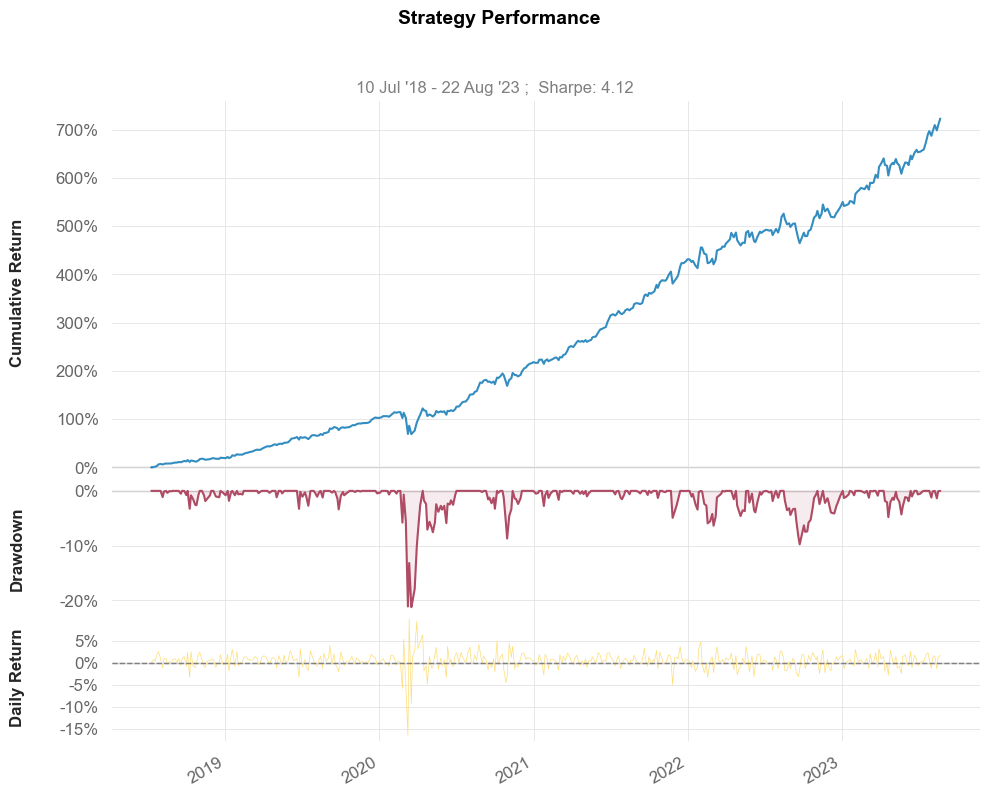

In [18]:
import scipy
# Constants
portfolio_size = 1000000

# Start with the initial portfolio size
portfolio_values_list = [portfolio_size]
date_chart_horizon = [date_col[0]]

# Initialize DataFrames outside the loop
forecasted_returns_df = pd.DataFrame()
realised_returns_df = pd.DataFrame()
all_weights = {}

# Fill DataFrames by iterating through forecasts_per_model
for key in forecasts_per_model.keys():
    if key[0] in securities_high_corr and key[1] == horizon:
        dates = forecasts_per_model[key]['date']
        # Get the date and forecasted/actual series
        forecasted_series = pd.Series(forecasts_per_model[key]['forecast'], index=dates, name=key[0])
        actual_series = pd.Series(forecasts_per_model[key]['actual'], index=dates, name=key[0])

        # If DataFrames are empty, set the index
        if forecasted_returns_df.empty:
            forecasted_returns_df = pd.DataFrame(index=dates)
        if realised_returns_df.empty:
            realised_returns_df = pd.DataFrame(index=dates)

        # Merging the forecasted and actual series with the corresponding DataFrames
        forecasted_returns_df = pd.concat([forecasted_returns_df, forecasted_series], axis=1)
        realised_returns_df = pd.concat([realised_returns_df, actual_series], axis=1)

for horizon in horizons:
    # Loop over dates
    for i in range(0, len(forecasted_returns_df),horizon):

        # Drop NaN values from forecasted and realized returns
        forecasted_returns_series = forecasted_returns_df.iloc[i].dropna()
        realised_returns_series = realised_returns_df.iloc[i].dropna()

        # Create a mask for the common securities
        common_securities_mask = forecasted_returns_series.index

        # Get the date corresponding to the current row i in forecasted_returns_df
        current_date = forecasted_returns_df.index[i].date()  # Extract date only, without time
        current_date = current_date.strftime('%Y-%m-%d')

        # Store date for chart
        date_chart_horizon.append(current_date)
        
        # Retrieve actual returns for the current date from df_all_returns
        actual_daily_returns = df_all_returns.loc[current_date, common_securities_mask]

        # Calculate the covariance matrix using the rolling window
        start_idx = df_all_returns.index.get_loc(current_date) - rolling_window
        end_idx = start_idx + rolling_window
        cov_matrix_returns = df_all_returns.iloc[start_idx:end_idx][common_securities_mask].cov()

        # Skip if NaN values in covariance matrix
        if cov_matrix_returns.isnull().any().any():
            print(f"Skipping index {i} due to NaN values in covariance matrix.")
            continue

        # Create the Efficient Frontier Object
        ef = EfficientFrontier(forecasted_returns_series, cov_matrix_returns,weight_bounds=(-0.1, 0.1))
        #ef.efficient_risk(target_volatility=0.05,market_neutral=True) # similar to quadratic
        #ef.max_quadratic_utility()
        #ef.max_quadratic_utility(market_neutral=True)
        #ef.min_volatility() 
        ef.efficient_return(0.01)
        #ef.max_sharpe()
        
        # Get the cleaned weights
        cleaned_weights = ef.clean_weights()
        all_weights[current_date] = cleaned_weights
        
        # Calculate the weighted return for each asset using actual daily returns
        weighted_returns = {ticker: weight * realised_returns_series[ticker] for ticker, weight in cleaned_weights.items()}

        # Calculate the portfolio return percentage
        portfolio_return_percentage = sum(weighted_returns.values())

        # Update the portfolio value based on the percentage return
        portfolio_value = portfolio_values_list[-1] * (1 + portfolio_return_percentage)

        # Append the new portfolio value to the list
        portfolio_values_list.append(portfolio_value)
        
# Create a DataFrame with the portfolio values and dates
portfolio_values_df = pd.DataFrame({
    'Date': date_chart_horizon,
    'Portfolio Value': portfolio_values_list[:]
})

# Calculate daily returns
portfolio_values_df['Daily Returns'] = portfolio_values_df['Portfolio Value'].pct_change()

# Set the date as the index
portfolio_values_df['Date'] = pd.to_datetime(portfolio_values_df['Date'])
portfolio_values_df.set_index('Date', inplace=True)

qs.plots.snapshot(portfolio_values_df['Daily Returns'], title='Strategy Performance', show=True)

In [15]:

import plotly.graph_objects as go

# Extract unique tickers from the dictionary
tickers = list(all_weights[list(all_weights.keys())[0]].keys())

# Create traces for each ticker
traces = []
for ticker in tickers:
    weights = [all_weights[date][ticker] for date in all_weights]
    trace = go.Scatter(
        x=list(all_weights.keys()),
        y=weights,
        name=ticker
    )
    traces.append(trace)

# Create the layout
layout = go.Layout(
    title="Weights of Stocks Across Dates",
    barmode='stack',
    xaxis_title="Date",
    yaxis_title="Weight"
)

# Create the figure and add traces
fig = go.Figure(data=traces, layout=layout)

# Show the plot
fig.show()

In [11]:
print(portfolio_value)

1.5689316168343428e+27


In [40]:
import pickle

long_positions = {}
short_positions = {}
portfolio_size = [500000]

# Define the start and end dates for downloading the price data
start_date = current_date
end_date = datetime.now().strftime('%Y-%m-%d')

# Download the price data
price_data = yf.download(tickers=securities_high_corr, start=start_date, end=end_date, progress=False)

# Get the most recent closing prices
prices_dict = price_data['Adj Close'].iloc[-1].to_dict()

# Get the latest portfolio weights
_, latest_weights = next(reversed(all_weights.items()))

# Calculate the amount of money invested in each security
investment_dict = {ticker: weight * portfolio_size[0] for ticker, weight in latest_weights.items()}

# Calculate the number of shares to buy for each security
shares_to_trade_dict = {ticker: {'shares': investment // prices_dict[ticker], 'price': prices_dict[ticker]} for ticker, investment in investment_dict.items()}

# Store long and short positions
for ticker, data in shares_to_trade_dict.items():
    shares = data['shares']
    price = data['price']
    if shares > 0:
        long_positions[ticker] = shares
        print(f"Long {shares} shares of {ticker}. EOD close: {round(price,2)}")
    elif shares < 0:
        short_positions[ticker] = -shares
        print(f"Short {-shares} shares of {ticker}. EOD close: {round(price,2)}")

with open('new_portfolio_positions.pkl', 'wb') as f:
    pickle.dump(shares_to_trade_dict, f)

Short 1537.0 shares of SYF. EOD close: 32.54
Long 76.0 shares of V. EOD close: 245.34
Long 304.0 shares of JNJ. EOD close: 164.31
Long 455.0 shares of XOM. EOD close: 109.81
Long 312.0 shares of WMT. EOD close: 160.05
Long 826.0 shares of KO. EOD close: 60.5
Long 276.0 shares of PEP. EOD close: 180.93
Long 192.0 shares of AMGN. EOD close: 259.64
Short 155.0 shares of ACN. EOD close: 323.45
Short 1199.0 shares of C. EOD close: 41.72
Long 740.0 shares of NEE. EOD close: 67.51
Long 156.0 shares of TXN. EOD close: 170.69
Long 56.0 shares of AVGO. EOD close: 889.93
Long 129.0 shares of LIN. EOD close: 386.85
Long 223.0 shares of UNP. EOD close: 223.44
Short 428.0 shares of WFC. EOD close: 42.0
Long 504.0 shares of SBUX. EOD close: 99.15
Short 400.0 shares of PLD. EOD close: 125.1
Long 111.0 shares of LMT. EOD close: 448.4
Long 161.0 shares of ISRG. EOD close: 310.39
Long 320.0 shares of SCHW. EOD close: 59.45
Short 422.0 shares of ICE. EOD close: 118.57
Long 186.0 shares of BIIB. EOD close:

In [41]:
# Calculate total long, short and net exposure
long_exposure = sum([shares * prices_dict[ticker] for ticker, shares in long_positions.items()])
short_exposure = sum([shares * prices_dict[ticker] for ticker, shares in short_positions.items()])
net_exposure = long_exposure - short_exposure

print("Portfolio Margin: ${:,.2f}".format(portfolio_size[-1]))
print("\nPortfolio Long Exposure: ${:,.2f}".format(long_exposure))
print("Portfolio Short Exposure: ${:,.2f}".format(short_exposure))
print("Portfolio Net Exposure: ${:,.2f}".format(net_exposure))
print('Portfolio Gross Exposure: ${:,.2f}'.format(long_exposure + short_exposure))
print('Portfolio Tilt %: {:,.2f}'.format((long_exposure - short_exposure)/(long_exposure + short_exposure)*100))
print('Portfolio Leverage: {:,.2f}'.format((long_exposure + short_exposure) / portfolio_size[-1]))


Portfolio Margin: $500,000.00

Portfolio Long Exposure: $1,161,996.21
Portfolio Short Exposure: $665,313.20
Portfolio Net Exposure: $496,683.01
Portfolio Gross Exposure: $1,827,309.40
Portfolio Tilt %: 27.18
Portfolio Leverage: 3.65


In [39]:
shares_to_trade_dict['CCI']

{'shares': 752.0, 'price': 99.69999694824219}

In [31]:
# Define current_portfolio_positions
current_portfolio_positions = {
    'SYF': -2184, 'V': 100, 'JNJ': 443, 'XOM': 698, 'WMT': 454, 'KO': 1234, 'PEP': 260, 'AMGN': 215, 
    'ACN': 241, 'C': -1641, 'NEE': 1084, 'TXN': -446, 'AVGO': 20, 'LIN': 198, 'UNP': -162, 'WFC': -1071, 
    'SBUX': -745, 'PLD': -93, 'LMT': 168, 'ISRG': 242, 'SCHW': 1155, 'ICE': -658, 'BIIB': -40, 'DUK': 838, 
    'SYK': 191, 'AON': -239, 'MET': -598, 'ES': 1115, 'AEP': 923, 'VRTX': 220, 'D': 1524, 'SO': -1106, 
    'COF': 661, 'MMC': 395, 'ADP': 305, 'EFX': -264, 'PAYX': 609, 'MNST': 797, 'VRSK': -327, 'ETR': -769
}

# Compute the delta positions again
delta_positions = {}

# For every position in current_portfolio_positions
for stock, current_position in current_portfolio_positions.items():
    if stock in shares_to_trade_dict:
        delta_positions[stock] = shares_to_trade_dict[stock]['shares'] - current_position
    else:
        # Fully liquidate the position
        delta_positions[stock] = -current_position

# For every position in shares_to_trade_dict that isn't in current_portfolio_positions
for stock, trade_data in shares_to_trade_dict.items():
    if stock not in current_portfolio_positions:
        delta_positions[stock] = trade_data['shares']

delta_positions


{'SYF': -171.0,
 'V': 15.0,
 'JNJ': 8.0,
 'XOM': -6.0,
 'WMT': 21.0,
 'KO': 7.0,
 'PEP': 158.0,
 'AMGN': 77.0,
 'ACN': -477.0,
 'C': -178.0,
 'NEE': 19.0,
 'TXN': 685.0,
 'AVGO': 68.0,
 'LIN': -2.0,
 'UNP': 496.0,
 'WFC': 418.0,
 'SBUX': 1530.0,
 'PLD': -519.0,
 'LMT': -2.0,
 'ISRG': 10.0,
 'SCHW': -664.0,
 'ICE': 10.0,
 'BIIB': 323.0,
 'DUK': -1646.0,
 'SYK': -277.0,
 'AON': 13.0,
 'MET': 1784.0,
 'ES': 35.0,
 'AEP': -1869.0,
 'VRTX': -225.0,
 'D': -3070.0,
 'SO': 2207.0,
 'COF': 82.0,
 'MMC': -782.0,
 'ADP': -9.0,
 'EFX': -115.0,
 'PAYX': -982.0,
 'MNST': -2105.0,
 'VRSK': 643.0,
 'ETR': 1560.0,
 'CCI': 752.0}

In [33]:
file_name = "/Users/davidesecoli/Desktop/Artificial_Intelligence/IB/Jupyter/ib_shares_output.txt"

with open(file_name, 'w') as file:
    for stock, delta in delta_positions.items():
        file.write(f"{stock}: {delta}\n")

file_name

'/Users/davidesecoli/Desktop/Artificial_Intelligence/IB/Jupyter/ib_shares_output.txt'

[*********************100%***********************]  1 of 1 completed
Avg Win: 0.05
Avg Loss: -0.04
Avg Return: 0.02
Best: 0.16
Worst: -0.18
Conditional Value At Risk: -0.11
Expected Return: 0.02
Expected Shortfall: -0.11
Exposure: 0.99
Gain To Pain Ratio: 1.59
Geometric Mean: 0.02
Information Ratio: 0.36
Kelly Criterion: 0.42
Kurtosis: 2.47
Max Drawdown: -0.18
Outlier Win Ratio: 3.12
Outlier Loss Ratio: 3.3
Payoff Ratio: 1.16
Probabilistic Ratio: 1.0
Probabilistic Sharpe Ratio: 1.0
Probabilistic Sortino Ratio: 1.0
Profit Factor: 2.59
Profit Ratio: 0.5
R2: 0.0
Recovery Factor: 13.49
Risk Of Ruin: 0.0
Risk Return Ratio: 0.36
Ror: 0.0
Serenity Index: 28.19
Sharpe: 5.74
Skew: -0.58
Smart Sharpe: 3.98
Smart Sortino: 6.79
Sortino: 9.78
Tail Ratio: 1.39
Value At Risk: -0.07
Var: -0.07
Volatility: 0.85
Win Loss Ratio: 1.16
Win Rate: 0.69


<Figure size 1000x600 with 0 Axes>

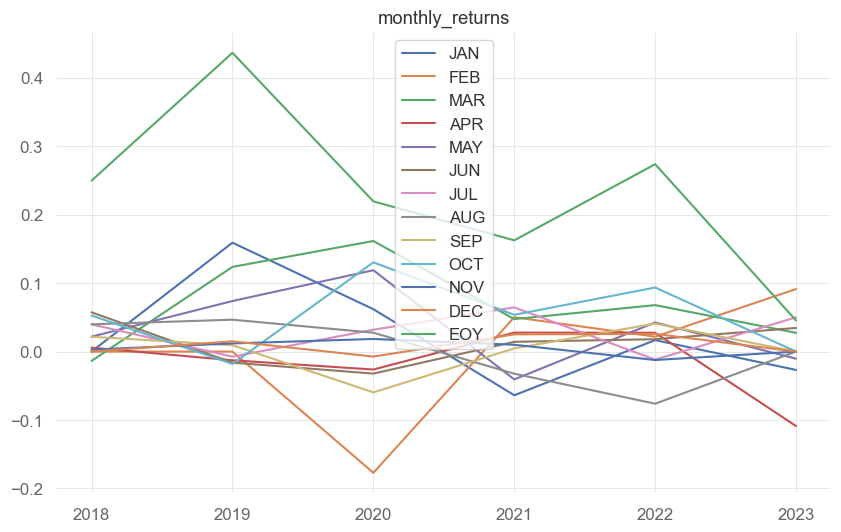

In [36]:

def strategy_report(strategy_returns, benchmark_returns=None):

    # List of methods that return a single value
    single_value_methods = ['avg_win','avg_loss', 'avg_return', 'best', 'worst',
                            'conditional_value_at_risk',
                            'expected_return', 'expected_shortfall', 'exposure', 'gain_to_pain_ratio',
                            'geometric_mean', 'information_ratio', 'kelly_criterion',
                            'kurtosis', 'max_drawdown', 'outlier_win_ratio','outlier_loss_ratio',
                            'payoff_ratio', 'probabilistic_ratio',
                            'probabilistic_sharpe_ratio', 'probabilistic_sortino_ratio', 'profit_factor',
                            'profit_ratio', 'r2', 'recovery_factor', 'risk_of_ruin', 'risk_return_ratio',
                            'ror', 'serenity_index', 'sharpe', 'skew', 'smart_sharpe', 'smart_sortino',
                            'sortino', 'tail_ratio', 'value_at_risk', 'var', 'volatility',
                            'win_loss_ratio', 'win_rate']
    
    # Loop through the methods and print the results
    for method in single_value_methods:
        func = getattr(qs.stats, method)
        if 'benchmark' in func.__code__.co_varnames:
            result = func(strategy_returns, benchmark_returns)
        else:
            result = func(strategy_returns)

        # Transform method name
        formatted_method = ' '.join([word.capitalize() for word in method.split('_')])

        print(f"{formatted_method}: {round(result,2)}")

    
    # Methods that return plots
    plot_methods = ['monthly_returns']

    for method in plot_methods:
        plt.figure(figsize=(10, 6))

        if method in ['monthly_returns']:  # Add other methods if needed
            series = getattr(qs.stats, method)(strategy_returns)
            series.plot()
        else:
            func = getattr(qs.stats, method)
            if 'benchmark' in func.__code__.co_varnames:
                func(strategy_returns, benchmark_returns)
            else:
                func(strategy_returns)

        plt.title(f"{method}")
        plt.show()

# Fetch benchmark returns
benchmark_data = yf.download('^GSPC', start=portfolio_values_df.index.min(), end=portfolio_values_df.index.max())
benchmark_returns = benchmark_data['Adj Close'].pct_change().dropna()


# Test the function
strategy_report(portfolio_values_df['Daily Returns'], benchmark_returns)